<a href="https://colab.research.google.com/github/Vngel0/Python_UC/blob/main/Prueba_Supervisada.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## Prueba de  Modelos supervisados
![image.png](attachment:95702e4f-3c23-4c14-b887-82214f262d60.png)

#### Pontificia Universidad Católica de Chile
Diplomado en Data Science

Septiembre 2021


### Nombre:


Utilizaremos un set de datos de las policias de New York del año 2009 y 2010. (`2009_1perc.csv` y `2010_1perc.csv`) los cuales nos darán información de los procedimientos policiales realizados. Además se le entregará el diccionario de variables para que pueda consultar que significa cada categoría dentro de las variables.

- La variable respuesta 'arstmade' informa si los procedimientos policiales han terminado en arresto o no, y el objetivo será realizar un modelo de Machine Learning para predecir si un futuro procedimiento terminará en arresto.

# 1.- Enliste todas las librerias que utilizará (0.5 puntos)
Nota: Se recomienda ir actualizando la lista conforme las necesidades vaya teniendo durante el desarrollo de la prueba

In [ ]:
!pip install pandas-profiling[notebook]

In [10]:
import pandas as pd
import pandas_profiling as pp
from pandas_profiling import ProfileReport
import numpy as np
import missingno as msngo

# 2.- Importación y revisión de los datos (1 punto)

Importe ambos sets. Dado que la fuente de datos proviene de la misma base, tienen las mismas columnas. Consolide ambos sets y reporte una exploración *básica* de los datos (numero de filas/columnas, tipos de datos, estadísticas básicas, casos perdidos)

In [ ]:
datos_2009 = pd.read_csv("/content/2009_1perc.csv")
datos_2010 = pd.read_csv("/content/2010_1perc.csv")

datos = pd.concat([datos_2009, datos_2010])




In [ ]:
datos.head(5)

,Unnamed: 0,year,pct,ser_num,datestop,timestop,recstat,inout,trhsloc,perobs,crimsusp,perstop,typeofid,explnstp,othpers,arstmade,arstoffn,sumissue,sumoffen,compyear,comppct,offunif,officrid,frisked,searched,contrabn,adtlrept,pistol,riflshot,asltweap,knifcuti,machgun,othrweap,pf_hands,pf_wall,pf_grnd,pf_drwep,pf_ptwep,pf_baton,pf_hcuff,...,sb_admis,sb_other,repcmd,revcmd,rf_furt,rf_bulg,offverb,offshld,sex,race,dob,age,ht_feet,ht_inch,weight,haircolr,eyecolor,build,othfeatr,addrtyp,rescode,premtype,premname,addrnum,stname,stinter,crossst,aptnum,city,state,zip,addrpct,sector,beat,post,xcoord,ycoord,dettypcm,linecm,detailcm
0,178048,2009,41,1779,4032009,130,A,O,P,1.0,CPW,2,P,Y,N,N,,N,,0,0,Y,,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,...,N,N,41,41,N,N,,,M,B,7111984,24,5,9,145,BK,BR,M,,L,,,STREET,957,KELLY STREET,WESTCHESTER AVENUE,EAST 163 STREET,,BRONX,,,41,G,7,,1013067,0238633,CM,1,20
1,498873,2009,108,5805,10292009,1050,A,O,P,3.0,BURG,5,P,Y,Y,N,,N,,0,0,N,,Y,Y,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,...,N,N,108,108,Y,N,V,S,M,A,12151993,15,5,5,140,BK,BR,T,,L,,,STREET,,,63 STREET,37 AVENUE,,QUEENS,,,108,J,,,1012043,0212157,CM,1,14
2,463573,2009,43,8340,10062009,1450,1,O,P,1.0,MISD,1,V,Y,N,N,,N,,0,0,N,,Y,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,...,N,N,43,43,Y,N,,S,M,Q,7031987,21,6,3,220,BR,BR,M,,L,,,STREET,,,WATSON AVENUE,WHEELER AVENUE,,BRONX,,,43,E,,,1017599,0240200,CM,1,20
3,43626,2009,77,932,1232009,1843,A,O,P,5.0,MIS,5,P,Y,N,N,,N,,0,0,Y,,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,...,N,N,77,77,N,N,,,M,B,3131986,22,5,5,120,BK,BR,T,,L,,,STREET,249,SCHENECTADY AVENUE,LINCOLN PLACE,SAINT JOHNS PLACE,,BROOKLYN,,,77,J,4,35,1002625,0183442,CM,1,24
4,563921,2009,110,11224,12132009,1655,A,O,P,3.0,CPW,10,P,Y,Y,N,,N,,0,0,Y,,Y,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,...,N,N,110,110,Y,Y,,,M,Q,9221991,18,5,6,165,BK,BR,M,,L,,,SIDEWALK,,,53 AVENUE,108 STREET,,QUEENS,,,110,H,,,1024535,0209890,CM,1,20


In [ ]:
datos.shape

#Tenemos 11825 registros y 112 variables


(11825, 112)

In [ ]:
datos.replace(' ', np.nan, inplace=True) 

In [ ]:
display(datos.info())

#Tenemos 7 float
#Tenemos 16 int
#Tenemos 89 object

<class 'pandas.core.frame.DataFrame'>
Int64Index: 11825 entries, 0 to 6012
Columns: 112 entries, Unnamed: 0 to detailcm
dtypes: float64(7), int64(16), object(89)
memory usage: 10.2+ MB


None

In [ ]:
profile = ProfileReport(datos, title="Pandas Profiling Report")

In [ ]:
profile

Summarize dataset:   0%|          | 0/126 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

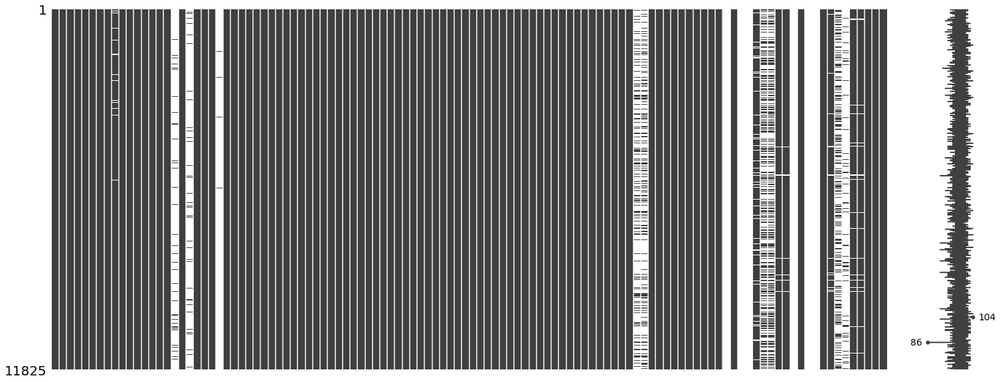

In [ ]:
msngo.matrix(datos);

Como podemos observar en nuestros reportes, tenemos un total de 156.956 missing. En el gráfico podemos ver que hay variables que tienen muchos missing.

In [ ]:
datos.describe()

,Unnamed: 0,year,pct,ser_num,datestop,timestop,perobs,perstop,compyear,comppct,repcmd,revcmd,dob,age,ht_feet,ht_inch,weight,othfeatr,rescode,premtype,aptnum,state,zip
count,11825.000000,11825.000000,11825.000000,11825.000000,1.182500e+04,11825.000000,11825.000000,11825.000000,11825.0,11825.0,11825.000000,11825.000000,1.182500e+04,11825.000000,11825.000000,11825.000000,11825.000000,0.0,0.0,0.0,0.0,0.0,0.0
mean,295983.814799,2009.508499,68.625624,5697.994334,6.364221e+06,1413.725497,2.654391,5.649556,0.0,0.0,243.354926,238.986385,7.316195e+06,28.968541,5.183340,6.408034,170.093615,NaN,NaN,NaN,NaN,NaN,NaN
std,170820.705702,0.499949,33.037826,5152.486022,3.429091e+06,744.726359,9.759031,9.758535,0.0,0.0,297.788599,299.394740,3.729206e+06,29.205278,0.398801,3.405503,37.195884,NaN,NaN,NaN,NaN,NaN,NaN
min,52.000000,2009.000000,1.000000,1.000000,1.012009e+06,0.000000,0.000000,1.000000,0.0,0.0,1.000000,1.000000,1.011900e+06,1.000000,3.000000,0.000000,1.000000,NaN,NaN,NaN,NaN,NaN,NaN
25%,147515.000000,2009.000000,42.000000,2002.000000,3.232009e+06,1000.000000,1.000000,3.000000,0.0,0.0,70.000000,66.000000,4.121982e+06,19.000000,5.000000,4.000000,150.000000,NaN,NaN,NaN,NaN,NaN,NaN
50%,296652.000000,2010.000000,73.000000,4366.000000,6.162010e+06,1605.000000,1.000000,5.000000,0.0,0.0,105.000000,103.000000,7.261982e+06,25.000000,5.000000,7.000000,170.000000,NaN,NaN,NaN,NaN,NaN,NaN
75%,443097.000000,2010.000000,102.000000,7840.000000,9.232009e+06,2035.000000,3.000000,5.000000,0.0,0.0,177.000000,176.000000,1.105199e+07,34.000000,5.000000,9.000000,180.000000,NaN,NaN,NaN,NaN,NaN,NaN
max,601281.000000,2010.000000,123.000000,31694.000000,1.231201e+07,2830.000000,926.000000,857.000000,0.0,0.0,879.000000,879.000000,1.231200e+07,999.000000,7.000000,11.000000,999.000000,NaN,NaN,NaN,NaN,NaN,NaN


# 3.- Preprocesamiento de datos (1 punto)
Habrá notado que los datos parecen tener ciertas inconsistencias. Siga los siguientes pasos para limpiar este set:

- 3.1 Obtenga una lista con todas las variables categoricas que tengan entre 2 y 99 categorías (inclusive). (hint: son las variables tipo categoricas

In [ ]:
datos_categoricos = datos.select_dtypes(include='object')
datos_categoricos

In [ ]:
profile_categoricos = ProfileReport(datos_categoricos, title="Pandas Profiling Report")

In [ ]:
profile_categoricos

In [ ]:
excluir = ["crimsusp","arstoffn","sumoffen","premname","addrnum","stname","stinter","crossst","xcoord","ycoord"]
datos_categoricos = datos_categoricos.drop(excluir,axis=1)

Variable limpia. Tenemos 79 variables categoricas, las cuales poseen entre 2 y 99 categorias.

- 3.2 Reemplaze las siguientes clases faltantes:

  -Si alguna categoría de las columnas officrid, offshld o offverb es igual a "" cambielo a 'N' y en caso contrario dejelo como 'Y'
  
  -Si alguna categoría de las columnas sector, trhsloc o beat es igual a "" (o NA, dependiendo de como haya catgado la base de datos), cambielo a 'U' y en caso contrario mantenga su valor
  
Nota, los valores significan {N: No, Y: Yes, U: Unknown}

In [ ]:
datos_categoricos[["officrid", "offshld", "offverb"]] = datos_categoricos[["officrid", "offshld", "offverb"]]. replace (np.nan, "N")

In [ ]:
df1=datos_categoricos[["officrid", "offshld", "offverb"]]
profile_df1 = ProfileReport(df1, title="Pandas Profiling Report")

In [ ]:
profile_df1

In [ ]:
datos_categoricos[["officrid"]] = datos_categoricos[["officrid"]]. replace ("I", "Y")
datos_categoricos[["offshld"]] = datos_categoricos[["offshld"]]. replace ("S", "Y")
datos_categoricos[["offverb"]] = datos_categoricos[["offverb"]]. replace ("V", "Y")


In [ ]:
datos_categoricos[["officrid", "offshld", "offverb"]]

In [ ]:
datos_categoricos

In [ ]:
datos_categoricos[["sector", "trhsloc", "beat"]] = datos_categoricos[["sector", "trhsloc", "beat"]]. replace (np.nan, "U")

In [ ]:
datos_categoricos[["sector", "trhsloc", "beat"]]

- 3.3 Transforme las columnas ht_feet junto con ht_inch en una única columna (de la forma "ht_feet.ht_inch") llamado 'meters' (hint: transforme con el siguiente cálculo: metros = (pies+pulgadas)*0.3048)

In [ ]:
datos.info()

In [ ]:
datos_no_categoricos = datos.select_dtypes(exclude='object')
datos_no_categoricos

In [ ]:
def add(x, y):
    return (x + y)*0.3048

In [ ]:
datos_no_categoricos[["meters"]] = add(datos_no_categoricos["ht_feet"],datos_no_categoricos["ht_inch"])

In [ ]:
datos_no_categoricos

In [ ]:
datos_no_categoricos[["meters"]]

- 3.4 Note que la fecha viene en un formato MMDDAAAA en la columna datestop. Genere 2 nuevas columnas llamadas month y year que solo tenga el mes y el año respectivamente.

Hint: Explore la libreria lubridate https://www.rstudio.com/resources/cheatsheets/ 

In [ ]:
datos_no_categoricos[["datestop"]]

,datestop
0,4032009
1,10292009
2,10062009
3,1232009
4,12132009
...,...
6008,9262010
6009,7302010
6010,4302010
6011,11232010


In [ ]:
datos_no_categoricos[["year"]] = datos_no_categoricos[["datestop"]].str[-2:]


AttributeError: ignored

 - 3.5 Filtre su DataFrame y solo deje las columnas seleccionadas en el punto 3.1, el mes, el año, los metros y la edad. Luego solo deje los registros cuyas edades esten entre 18 y 100 años, ambos inclusive.

# 4.- Análisis exploratorio (1 punto)

- 4.1 Estudie la variable respuesta por si sola (arstmade), puede ayudarse de un gráfico. Comente

- 4.2.- Estudie la relación de la variable respuesta en comportamiento con la raza (race), comente.

- 4.3 Estudie la relación de la variable respuesta en comportamiento con la sexo (sex), comente.

- 4.3 Estudie la relación de la variable respuesta en comportamiento con la sexo y la edad en su conjunto, comente.

- 4.4 Recodifique la variable respuesta a 1 y 0. Donde 0 es N y 1 es Y

- 4.5 Muestre en un gráfico la probabilidad que un individuo sea arrestado,condicional al género y a la raza. ¿qué implicancias éticas tienen algunas conclusiones de lo que observa?.

# 5.- Determinar si el procedimiento policial concluirá en alguna acción violenta. (0.5 puntos)

Los atributos que tienen el prefijo pf (`['pf_hands'],['pf_wall'], ['pf_grnd'], ['pf_drwep'], ['pf_ptwep'],['pf_baton'],['pf_hcuff'], ['pf_pepsp'] y ['pf_other']`) indican si hubo fuerza fisica utilizada por el oficial al momento del procedimiento, con la marca 'Y'. 

Genere una nueva variable llamada 'violencia' la cual sea 1 si en cualquiera de las 9 variables pf hubo alguna 'Y', y 0 en otro caso. Luego indique el porcentaje de casos que terminaron con violencia.

# 6.- Modelación (2 puntos)

- 6.1 Genere las variables dummies correspondientes (Tenga cuidado de no utilizar variables que expliquen lo mismo, ¡recuerde que acaba de crear una variable a partir de otras!, además recuerde que creó una variable numérica que es una categoría :) ). Luego genere los sets de train-test  utilizando el año 2009 para entrenar, y el año 2010 para testear. (0.5 pts)

- 6.2  Entrene 4 modelos de clásificación y reporte el mejor modelo bajo algún criterio. Utilice validación cruzada de al menos 2 folds para probar distintos hiperparámetros para cada modelo (puede probar cualquier hiperparámetro, pero debe ser al menos uno). (1.5 pts)

# Bonus (0.5 pts)

¿Que puede hacer para mejorar la predicción de los modelos?